<a href="https://colab.research.google.com/github/pinballsurgeon/deluxo_adjacency/blob/main/Davinici_dual.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# divinci 3 review
### early baselining platform



In [90]:
# prompt_topics = ['Fusion', 'XGBoost', 'CPR', 'Molecular Spectroscopy', 'Quantum Circuits']
prompt_topics = {'High performance computing': 0.15
                ,'Machine Learning': 0.56
                ,'Quantum Computing': 0.76
                ,'Driver-less cars': 0.66
                ,'Cloud computing': 0.22
                ,'Distributed Computing': 0.30
                ,'Augmented Reality': 0.4
                 }

# maximum number of words to keep
max_vocab_size = 50000

### gpt3 parameters (0.8, 0.2, -0.5 parameters found to be best in comparable experiment, definitely test others)
response_length_param = 2000
temperature_param = .7            
frequency_penalty_param = 0.2
presence_penalty_param = -0.3


### GPT-3 engines
gpt3_engines = {'text-davinci-002':'o'
               ,'text-davinci-003':'s'
               }

generalized_list_request = "Return a comma seperated list of short terms representing important topics, people and technologies related to "
generalized_prompt = "Return deep details on the history, challenges, notable figures, and current day progress regarding "

## Installs

In [91]:
# install openai
!pip install openai

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## Imports

In [92]:
# gpt3 
import openai

# supply openai api key via file (a file uploaded simply containing your OpenAI token)
openai.api_key = open('openai_key').read()

# engineering
import pandas
import matplotlib.pyplot
import numpy
import re
import os
import time

# tensorflow
import tensorflow
from tensorboard.plugins import projector

# scikit
from sklearn.model_selection import train_test_split
from sklearn.decomposition import LatentDirichletAllocation

# gensim
!pip install --upgrade gensim
from gensim.models import Word2Vec

# nltk
import nltk
nltk.download('punkt')
nltk.download('stopwords')


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

## Helper functions

In [93]:
### OPENAI - Ask Davinci - build openai completion request, define parameters
def get_openai_response(question, response_length, engine):

    # format open au request
    response = openai.Completion.create(
                      engine=engine,
                      prompt=question,
                      temperature=temperature_param,
                      max_tokens=response_length,
                      top_p=1,
                      frequency_penalty=frequency_penalty_param,
                      presence_penalty=presence_penalty_param )

    # parse and process open ai response
    response_choices = response["choices"]

    # replace blanks
    response = response_choices[0]["text"].strip()

    return response

In [94]:
def vectorize_text(tokens):

  model = Word2Vec(tokens,vector_size=50,sg=1,min_count=1)

  words=list(model.wv.index_to_key)

  materialized_model=model.wv[model.wv.index_to_key]
  df_materialized_model =pandas.DataFrame(materialized_model)

  return model, df_materialized_model, materialized_model

In [95]:
def correlation_matrix(df, materialized_model):
  #Computing the correlation matrix
  X_corr=df.corr()

  #Computing eigen values and eigen vectors
  values,vectors=numpy.linalg.eig(X_corr)

  #Sorting the eigen vectors coresponding to eigen values in descending order
  args = (-values).argsort()
  values = vectors[args]
  vectors = vectors[:, args]

  #Taking first 2 components which explain maximum variance for projecting
  new_vectors=vectors[:,:2]

  #Projecting it onto new dimesion with 2 axis
  neww_X=numpy.dot(materialized_model, new_vectors)

  return neww_X

In [96]:
def generate_list_of_subtopics(topic, engine):
  openai_response = get_openai_response(generalized_list_request + topic, response_length_param, engine) 
  text=re.sub(r"[^,.A-Za-z]",' ', openai_response)
  text=text.replace(',','88')
  text_arr=text.split(' ')
  text_arr=[w.lower() for w in text_arr if w.lower() not in stopwords]

  text = ' '.join(text_arr)
  sentence = re.split(r',|-|88|  ', text)
  sentence=[w.strip() for w in sentence]

  return sentence

In [97]:
def que_get_openai_response(question, response_length, engine):

  for _ in range(3):
      try:
        response = get_openai_response(question, response_length, engine)
      except:
          time.sleep(5)
          continue
      else:
          break
  else:
      response = 'GPT3 QUERY FAIL'

  return response

## Runtime Buffers

In [98]:
df_responses_store = pandas.DataFrame()
lst_responses = []
run_count = 0

# regex remove all non-alpha
regex = re.compile('[^a-zA-Z]')

stopwords = nltk.corpus.stopwords.words('english')

## Prompts

In [99]:
# iterate through combinations of questions and engines
# for prompt_topic in prompt_topics.keys():
#   for engine in gpt3_engines.keys():

for engine in gpt3_engines.keys():
  for prompt_topic in prompt_topics.keys():
    for sub_topic in generate_list_of_subtopics(prompt_topic, engine):

      # increment
      run_count += 1

      # map colors
      prompt_color = prompt_topics[prompt_topic]

      # start clock
      t0 = time.time()

      # perform query
      if len(sub_topic) < 30:
        openai_response = que_get_openai_response('From the perspective of ' + prompt_topic + '. ' + generalized_prompt + sub_topic, response_length_param, engine)

      # capture response 
      lst_responses.append([run_count                            # run number
                            , prompt_topic                       # prompt topic
                            , prompt_color                       # topic display color (matplot) 
                            , sub_topic                          # generated subtopic
                            , engine                             # engine
                            , gpt3_engines[engine]               # engine display shape (matplot) 
                            , openai_response                    # generated response
                            , len(openai_response)               # response length    
                            , len(openai_response.split(' '))    # token count
                            , int((time.time() - t0) * 1000)     # query run time
                            ])

      print('%s processed %s - %s query. resulting in %d tokens returned' % (engine, prompt_topic, sub_topic, int((time.time() - t0) * 1000)) )

# store responses in dataframe
df_responses_store = pandas.DataFrame(lst_responses, columns=['Experiment', 'Prompt', 'Prompt_Color', 'Sub_Topic', 'Engine'
                                                            , 'Engine_Shape', 'Response', 'Response_Length', 'Response_Token_Count','querytime_ms'])

# off line copy just in case
df_responses = df_responses_store


text-davinci-002 processed High performance computing - hpc query. resulting in 31645 tokens returned
text-davinci-002 processed High performance computing - high performance computing query. resulting in 5374 tokens returned
text-davinci-002 processed High performance computing - supercomputers query. resulting in 9794 tokens returned
text-davinci-002 processed High performance computing - gpus query. resulting in 10289 tokens returned
text-davinci-002 processed High performance computing - parallel computing query. resulting in 4783 tokens returned
text-davinci-002 processed High performance computing - multicore processors query. resulting in 7207 tokens returned
text-davinci-002 processed High performance computing - computer architecture query. resulting in 6422 tokens returned
text-davinci-002 processed High performance computing - cluster computing query. resulting in 5399 tokens returned
text-davinci-002 processed High performance computing - grid computing query. resulting in 

In [100]:
df_responses_backup = df_responses

In [120]:
df_responses = df_responses_backup

In [102]:
df_responses = df_responses[df_responses['Engine']=='text-davinci-002']

In [121]:
df_responses.loc[4, 'Response']

'.\n\nParallel computing is a computing paradigm in which multiple computations are performed at the same time, independently of each other. Parallel computing is a form of computation in which many calculations or the execution of processes are carried out simultaneously. Large problems can often be divided into smaller ones, which can then be solved at the same time.'

In [142]:
print(df_responses[['Prompt','Sub_Topic']].value_counts())

Prompt                 Sub_Topic            
Augmented Reality                               2
Cloud computing        cloud computing          2
                       virtualization           2
Distributed Computing  hadoop                   2
                       mapreduce                2
                                               ..
                       grid computing           1
                       distributed databases    1
                       deep learning            1
                       data visualization       1
Driver-less cars       bmw                      1
Length: 137, dtype: int64


## Analyze responses

In [123]:
response_register = {}

for index, row in df_responses.iterrows():
    text=re.sub(r"[^.A-Za-z]",' ', row['Response'])
    text_arr=text.split(' ')
    text_arr=[w.lower() for w in text_arr if w.lower() not in stopwords]
    text = ' '.join(text_arr)
    sentence=text.split('.')
    tokens=[nltk.word_tokenize(words) for words in sentence]
    

    model, df_materialized_model, materialized_model = vectorize_text(tokens)

    neww_X = correlation_matrix(df_materialized_model, materialized_model )

    response_instance = {}
    response_instance['model'] = model
    response_instance['projection'] = neww_X
    response_instance['prompt'] = row['Prompt']
    response_instance['sub_topic'] = row['Sub_Topic']

    response_register[index] = response_instance




/usr/local/lib/python3.7/dist-packages/matplotlib/collections.py:153: ComplexWarning: Casting complex values to real discards the imaginary part
  offsets = np.asanyarray(offsets, float)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/usr/local/lib/python3.7/dist-packages/matplotlib/text.py:1769: ComplexWarning: Casting complex values to real discards the imaginary part
  x = float(self.convert_xunits(x))
/usr/local/lib/python3.7/dist-packages/matplotlib/text.py:1771: ComplexWarning: Casting complex values to real discards the imaginary part
  y = float(self.convert_yunits(y))
/usr/local/lib/python3.7/dist-packages/matplotlib/text.py:828: ComplexWarning: Casting complex values to real discards the i

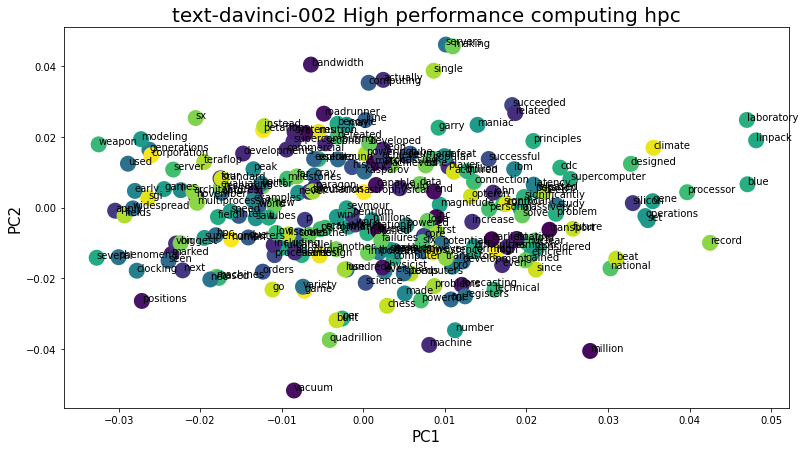

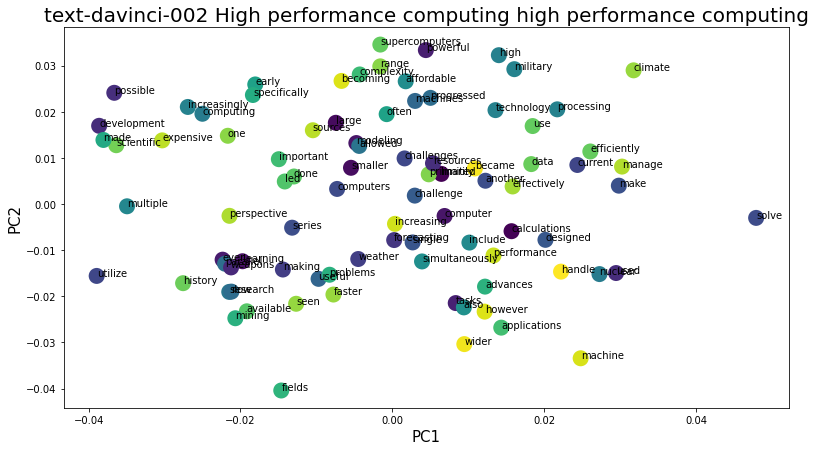

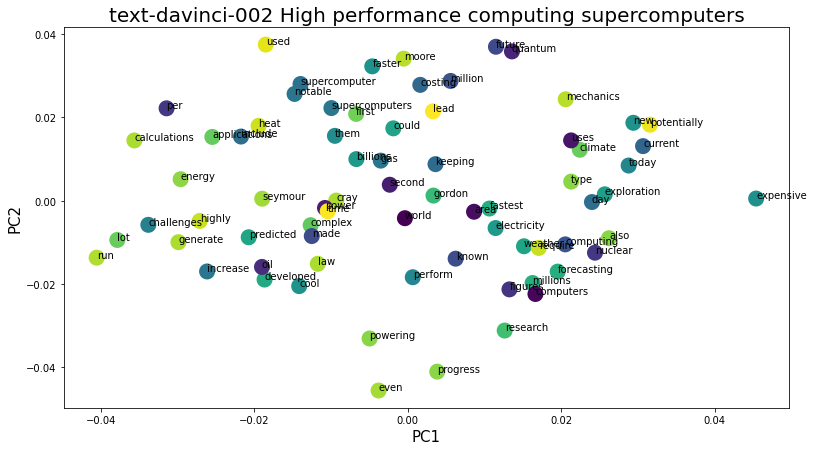

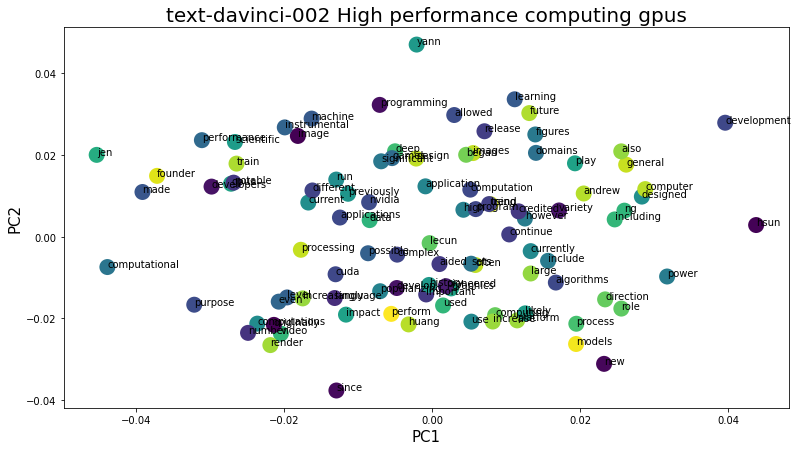

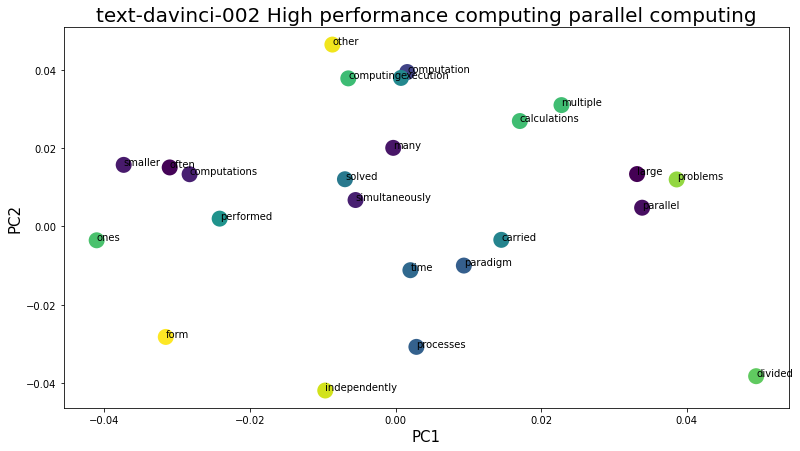

...

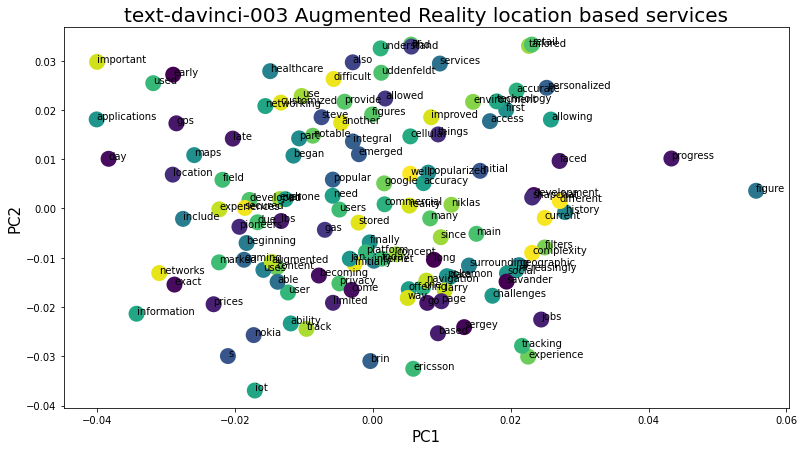

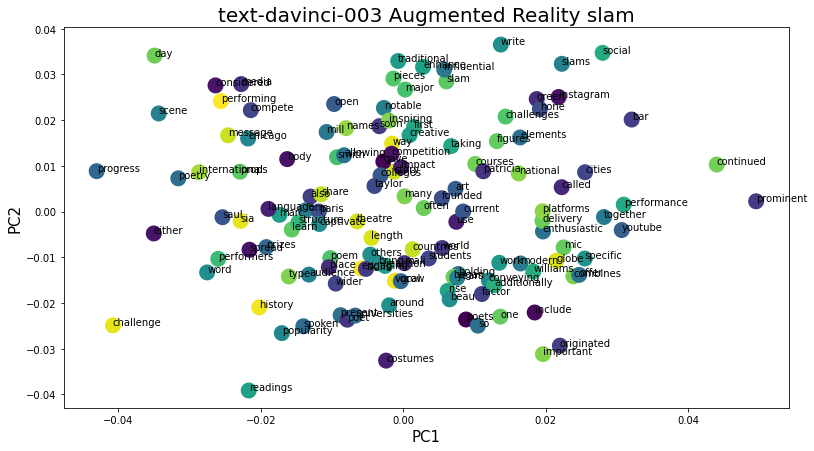

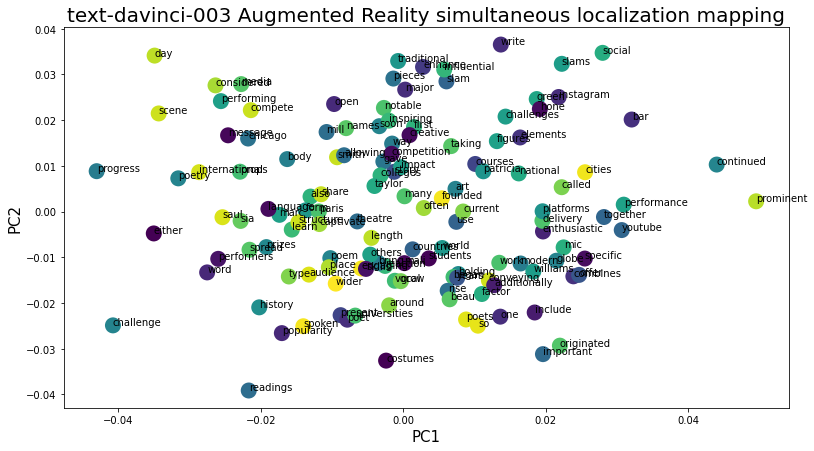

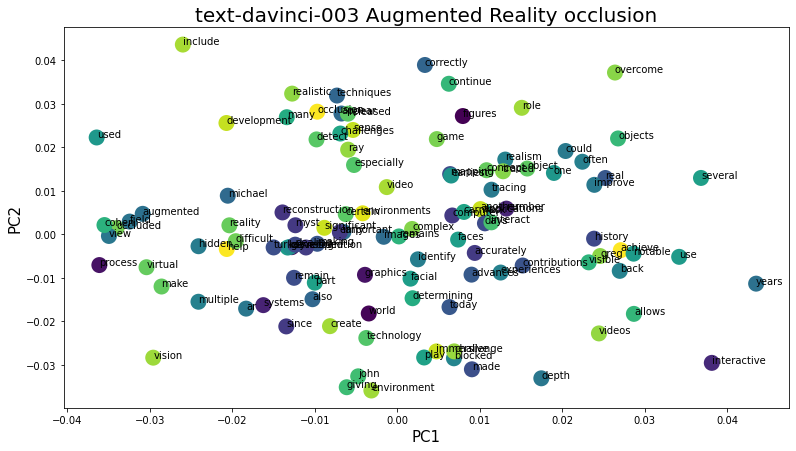

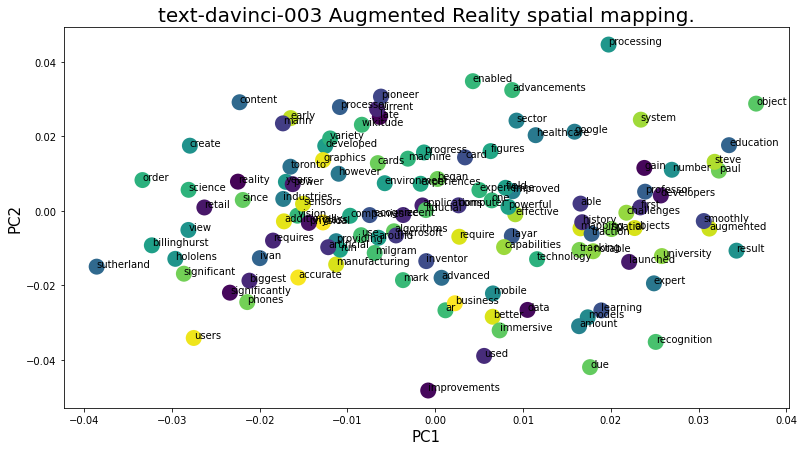

In [124]:
for response_instance in list(df_responses.index):

  df_responses.loc[response_instance, 'Engine']
  colors = numpy.random.rand(len(response_register[response_instance]['projection']))
  matplotlib.pyplot.figure(figsize=(13,7))
  matplotlib.pyplot.scatter(response_register[response_instance]['projection'][:,0],response_register[response_instance]['projection'][:,1],linewidths=10,c=colors)
  matplotlib.pyplot.xlabel("PC1",size=15)
  matplotlib.pyplot.ylabel("PC2",size=15)
  matplotlib.pyplot.title(df_responses.loc[response_instance, 'Engine'] + ' ' +
                          response_register[response_instance]['prompt'] + ' ' +
                          response_register[response_instance]['sub_topic'],size=20)
  vocab=list(response_register[response_instance]['model'].wv.index_to_key)
  for i, word in enumerate(vocab):
    matplotlib.pyplot.annotate(word,xy=(response_register[response_instance]['projection'][i,0],response_register[response_instance]['projection'][i,1]))

In [125]:
num_classes = len(df_responses['Engine'].value_counts())
colors = matplotlib.pyplot.cm.Dark2(numpy.linspace(0, 1, num_classes))
iter_color = iter(colors)

In [126]:
conditions = [
    (df_responses['Engine'] == 'text-davinci-002'),
    (df_responses['Engine'] == 'text-davinci-003')
    ]
choices = [0, 1]
df_responses['target'] = numpy.select(conditions, choices, default=0)
df_responses['target'].value_counts()


1    92
0    66
Name: target, dtype: int64

In [127]:
df_responses

,Experiment,Prompt,Prompt_Color,Sub_Topic,Engine,Engine_Shape,Response,Response_Length,Response_Token_Count,querytime_ms,target
0,1,High performance computing,0.15,hpc,text-davinci-002,o,High performance computing (HPC) is a field of...,6416,993,31645,0
1,2,High performance computing,0.15,high performance computing,text-davinci-002,o,.\n\nFrom the perspective of high performance ...,1369,197,5374,0
2,3,High performance computing,0.15,supercomputers,text-davinci-002,o,.\n\nSupercomputers are the fastest computers ...,1184,179,9794,0
3,4,High performance computing,0.15,gpus,text-davinci-002,o,", their impact on computing, and their current...",1560,235,10289,0
4,5,High performance computing,0.15,parallel computing,text-davinci-002,o,.\n\nParallel computing is a computing paradig...,368,58,4783,0
...,...,...,...,...,...,...,...,...,...,...,...
153,154,Augmented Reality,0.40,location based services,text-davinci-003,s,Location-based services (LBS) is a technology ...,2410,363,23254,1
154,155,Augmented Reality,0.40,slam,text-davinci-003,s,poetry.\n\nHistory\n\nSlam poetry is a type of...,1926,313,19034,1
155,156,Augmented Reality,0.40,simultaneous localization mapping,text-davinci-003,s,poetry.\n\nHistory\n\nSlam poetry is a type of...,1926,313,0,1
156,157,Augmented Reality,0.40,occlusion,text-davinci-003,s,Occlusion is a key concept in the field of Aug...,1890,297,20632,1


In [128]:
# target (default - gpt-3 Engine type)
y = tensorflow.keras.utils.to_categorical(df_responses["target"].values, num_classes=num_classes)

# features
df_responses['Response_clean'] = [regex.sub(' ', response) for response in df_responses['Response'].fillna(' ')]
df_responses['Response_clean'] = df_responses['Response_clean'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stopwords)]))

# test/train split
x_train, x_test, y_train, y_test = train_test_split(df_responses['Response_clean'], y, test_size=0.25)

In [129]:
# instance of the Tokenizer class
tokenizer = tensorflow.keras.preprocessing.text.Tokenizer(num_words=max_vocab_size)

# fit tokenizer on the train set
tokenizer.fit_on_texts(x_train)

# create numeric sequences for train and validation sets
sequences_train = tokenizer.texts_to_sequences(x_train)
sequences_test = tokenizer.texts_to_sequences(x_test)

In [130]:
# dictionary -> (word: integer)
wordindex_dict = tokenizer.word_index

# number of unique words
words = len(wordindex_dict)
  

In [131]:
data_train = tensorflow.keras.preprocessing.sequence.pad_sequences(sequences_train)
sequence_length = data_train.shape[1]
data_test = tensorflow.keras.preprocessing.sequence.pad_sequences(sequences_test, maxlen=sequence_length)

print('Shape of train tensor:', data_train.shape)
print('Shape of test tensor:', data_test.shape)

Shape of train tensor: (118, 713)
Shape of test tensor: (40, 713)


In [132]:
embedding_dimensionality = 3
hidden_state_dimensionality = 60

i = tensorflow.keras.layers.Input(shape=(sequence_length,))
x = tensorflow.keras.layers.Embedding(words+1, embedding_dimensionality)(i)
x = tensorflow.keras.layers.Dropout(0.3)(x)
x = tensorflow.keras.layers.Dense(100)(x)
x = tensorflow.keras.layers.Dropout(0.3)(x)
x = tensorflow.keras.layers.GlobalMaxPooling1D()(x)
x = tensorflow.keras.layers.Dense(num_classes, activation='softmax')(x)

model = tensorflow.keras.models.Model(i, x)

In [133]:
earlystop_callback = tensorflow.keras.callbacks.EarlyStopping(monitor='val_loss', 
                                                      patience=10, 
                                                      restore_best_weights=True)

METRICS = [  
      tensorflow.keras.metrics.CategoricalAccuracy(name="accuracy")  
]

model.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=METRICS
)

model_fit=model.fit(
  data_train,
  y_train,
  epochs=50,
  validation_data=(data_test, y_test),
  callbacks=[earlystop_callback]
)

Epoch 1/50
4/4 [==============================] - 1s 65ms/step - loss: 0.6969 - accuracy: 0.4407 - val_loss: 0.6932 - val_accuracy: 0.5000
Epoch 2/50
4/4 [==============================] - 0s 13ms/step - loss: 0.6843 - accuracy: 0.6102 - val_loss: 0.6947 - val_accuracy: 0.5000
Epoch 3/50
4/4 [==============================] - 0s 18ms/step - loss: 0.6729 - accuracy: 0.6102 - val_loss: 0.6973 - val_accuracy: 0.5000
Epoch 4/50
4/4 [==============================] - 0s 12ms/step - loss: 0.6671 - accuracy: 0.6102 - val_loss: 0.7004 - val_accuracy: 0.5000
Epoch 5/50
4/4 [==============================] - 0s 13ms/step - loss: 0.6647 - accuracy: 0.6102 - val_loss: 0.7040 - val_accuracy: 0.5000
Epoch 6/50
4/4 [==============================] - 0s 13ms/step - loss: 0.6626 - accuracy: 0.6102 - val_loss: 0.7072 - val_accuracy: 0.5000
Epoch 7/50
4/4 [==============================] - 0s 12ms/step - loss: 0.6596 - accuracy: 0.6102 - val_loss: 0.7095 - val_accuracy: 0.5000
Epoch 8/50
4/4 [===========

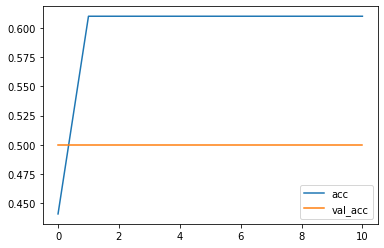

In [134]:
matplotlib.pyplot.plot(model_fit.history['accuracy'], label='acc')
matplotlib.pyplot.plot(model_fit.history['val_accuracy'], label='val_acc')
matplotlib.pyplot.legend()

In [135]:
from tensorboard.plugins import projector
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [136]:
# create logging directory
log_dir='/logs/fit/'
if not os.path.exists(log_dir):
    os.makedirs(log_dir)

# write wordindex dictionary
with open(os.path.join(log_dir, 'metadata.tsv'), "w") as f:
  for w in wordindex_dict:
    f.write("{}\n".format(w))

# weights from the embedding layer, in our case: model.layers[1]
weights_arr = [x*1 for x in model.layers[1].get_weights()[0][1:]]
weights = tensorflow.Variable(weights_arr)
checkpoint = tensorflow.train.Checkpoint(embedding=weights)
checkpoint.save(os.path.join(log_dir, "embedding.ckpt"))

# configuration set-up
config = projector.ProjectorConfig()
embedding = config.embeddings.add()
embedding.tensor_name = "embedding/.ATTRIBUTES/VARIABLE_VALUE"
embedding.metadata_path = 'metadata.tsv'
projector.visualize_embeddings(log_dir, config)

In [137]:

%load_ext tensorboard
%tensorboard --logdir /logs/fit/

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 2203), started 4:31:02 ago. (Use '!kill 2203' to kill it.)

<IPython.core.display.Javascript object>